# Data discovery and cleaning

In [1]:

import pandas as pd
pd.set_option('display.max_columns', 10)
pd.set_option('display.max_rows', 50)

In [2]:
products = pd.read_csv('./../input/raw_data.csv', low_memory = False, sep= '\t')

products.head(5)

,code,url,creator,created_t,created_datetime,...,choline_100g,phylloquinone_100g,beta-glucan_100g,inositol_100g,carnitine_100g
0,00000000000000225,http://world-en.openfoodfacts.org/product/0000...,nutrinet-sante,1623855208,2021-06-16T14:53:28Z,...,NaN,NaN,NaN,NaN,NaN
1,00000000000003429145,http://world-en.openfoodfacts.org/product/0000...,kiliweb,1630483911,2021-09-01T08:11:51Z,...,NaN,NaN,NaN,NaN,NaN
2,0000000000017,http://world-en.openfoodfacts.org/product/0000...,kiliweb,1529059080,2018-06-15T10:38:00Z,...,NaN,NaN,NaN,NaN,NaN
3,0000000000031,http://world-en.openfoodfacts.org/product/0000...,isagoofy,1539464774,2018-10-13T21:06:14Z,...,NaN,NaN,NaN,NaN,NaN
4,000000000003327986,http://world-en.openfoodfacts.org/product/0000...,kiliweb,1574175736,2019-11-19T15:02:16Z,...,NaN,NaN,NaN,NaN,NaN


In [3]:
print(products.shape)

columns = pd.DataFrame(products.columns, columns=['variable'])
columns.to_csv('./../docs/variables.csv', index=False, header=False)

(2059358, 187)


## Managing duplicates

In [4]:
products = products.drop_duplicates(subset='code', keep='last')
products.set_index('code', inplace=True)

## Managing incomplete values

In [5]:
na_values = pd.DataFrame(products.isna().sum())

var_with_na_values = na_values[na_values[0] != products.shape[0]]

var_with_na_values

,0
url,0
creator,4
created_t,0
created_datetime,0
last_modified_t,0
...,...
choline_100g,2059270
phylloquinone_100g,2057631
beta-glucan_100g,2059304
inositol_100g,2059268


### Completion rates of columns

In [6]:
def list_completion_rates(df):
    total_lines = df.shape[0]

    return round(df.isnull().sum() / total_lines, 2) \
        .sort_values(ascending = False) \
        .reset_index() \
        .rename(columns={'index': 'variable', 0 : 'incompletion_rate'})

In [7]:
list_completion_rates(products)

,variable,incompletion_rate
0,-melissic-acid_100g,1.0
1,-erucic-acid_100g,1.0
2,-gamma-linolenic-acid_100g,1.0
3,-dihomo-gamma-linolenic-acid_100g,1.0
4,omega-9-fat_100g,1.0
...,...,...
181,states,0.0
182,pnns_groups_2,0.0
183,pnns_groups_1,0.0
184,countries_en,0.0


In [8]:
nutriscores = products[['nutriscore_grade','nutriscore_score']].dropna()

nutriscores.describe()

,nutriscore_score
count,731711.000000
mean,9.113620
std,8.851187
min,-15.000000
25%,1.000000
50%,10.000000
75%,16.000000
max,40.000000


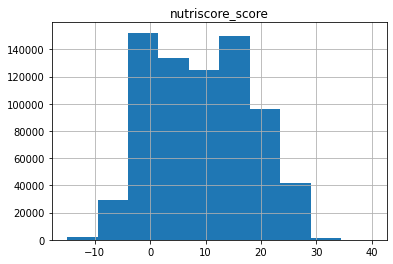

In [9]:
nutriscores.hist();

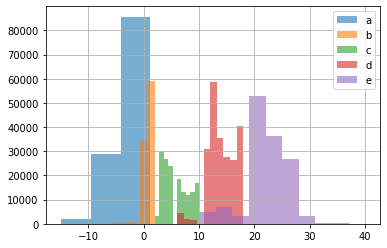

In [10]:
nutriscores.groupby('nutriscore_grade')['nutriscore_score'].hist(alpha=0.6, legend=True);

As can be seen here, the grades overlap because the calculation rules differ. If we popularize the nutriiscore calculation system, it depends on the calculations of negative and positive criteria. If we pose as __N__ like the nutriscore, __P__ the positive elements and __N__ the negative elements then the following general formula comes from :

> N = Σ<sub>__N__</sub> - Σ<sub>__P__</sub>






## Building our Data to training a model

We will need:
* Nutriscores (letters `nutriscore_grade` and numerical score `nutriscore_score`);
* Nutritional intakes to avoid: energy density (Kj / 100g), saturated fats (g / 100g), Simple sugars (g / 100g), Sodium (mg / 100g) or the columns `energy_100g`,` saturated_fat_100g`, `sugars_100g `,` sodium_100g`, `salt_100g`;


> To calculate the quantity of Sodium if not available, we will use the following approximation: salt content divided 3

* Nutritional contributions to be encouraged: Fruits and vegetables,
legumes and nuts (g / 100g) `fruits-vegetables-nuts_100g`, fibers (g / 100g)` fiber_100g` and proteins (g / 100g) `proteins_100g`;
* The product category in the NPPS sense (`pnns_groups_1`,` pnns_groups_2`) and `main_category`;

We will try to complete these variables as much as possible since according to the method of calculating the nutriscore, these are the necessary elements.

__We will therefore work on a data frame made up of these 13 variables and the objective will be to predict the variable `nutriscore_score`__


In [11]:

products = products[
    [
        'energy_100g',
        'saturated-fat_100g',
        'sugars_100g',
        'sodium_100g',
        'salt_100g',
        'nutriscore_score',
        'nutriscore_grade',
        'fruits-vegetables-nuts_100g',
        'fiber_100g',
        'proteins_100g',
        'pnns_groups_1',
        'pnns_groups_2',
        'main_category'
    ]
]

### Completion rates of lines

If the products are highly incomplete, we will not be able to complete them: we will therefore delete the products where more than 60% of the data is missing, considering that we will not be able to establish a model from so few data. 'information.

First we need to establish the function to calculate this horizontal completion rate.

In [12]:
products['completion_rate'] = round(products.count(axis=1) / products.shape[1], 2)

products

,energy_100g,saturated-fat_100g,sugars_100g,sodium_100g,salt_100g,...,proteins_100g,pnns_groups_1,pnns_groups_2,main_category,completion_rate
code,,,,,,,,,,,
00000000000000225,NaN,NaN,NaN,NaN,NaN,...,NaN,unknown,unknown,NaN,0.15
00000000000003429145,NaN,0.90,9.8,0.040,0.10,...,2.7,unknown,unknown,NaN,0.54
0000000000017,1569.0,3.08,15.0,0.560,1.40,...,7.8,unknown,unknown,NaN,0.62
0000000000031,NaN,NaN,NaN,NaN,NaN,...,NaN,unknown,unknown,NaN,0.15
000000000003327986,685.8,1.00,NaN,0.440,1.10,...,15.3,unknown,unknown,NaN,0.54
...,...,...,...,...,...,...,...,...,...,...,...
9999999910128,NaN,NaN,NaN,NaN,NaN,...,NaN,unknown,unknown,NaN,0.15
999999999,NaN,NaN,NaN,NaN,NaN,...,NaN,unknown,unknown,NaN,0.15
9999999990397,100.0,0.00,0.6,0.256,0.64,...,1.6,unknown,unknown,NaN,0.62


How is the completion of the products in our sample distributed?

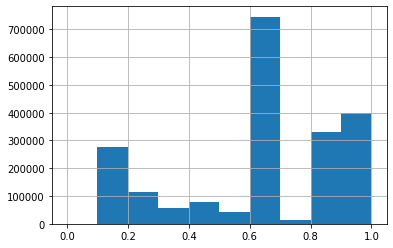

In [13]:
products.completion_rate.hist();

Good news, we see that the bulk of our products are 75% complete or more! We will only keep these "strongly supplemented" products for the future:

In [14]:
products = products[products.completion_rate >= 0.75]

products

,energy_100g,saturated-fat_100g,sugars_100g,sodium_100g,salt_100g,...,proteins_100g,pnns_groups_1,pnns_groups_2,main_category,completion_rate
code,,,,,,,,,,,
0000000000100,936.0,2.2,22.0,1.840,4.60,...,5.1,Fat and sauces,Dressings and sauces,en:mustards,0.92
0000000000949,134.0,0.1,3.9,0.168,0.42,...,0.9,Composite foods,One-dish meals,en:seasoned-shredded-carrots,0.85
0000000001281,1594.0,15.5,21.9,0.040,0.10,...,4.6,Sugary snacks,Biscuits and cakes,en:coconut-pies,0.92
0000000001885,657.0,0.0,27.0,0.000,0.00,...,0.6,Fruits and vegetables,Fruits,en:pear-compotes,0.92
0000000002257,598.0,1.0,1.0,0.108,0.27,...,1.9,Composite foods,One-dish meals,en:vegetables-macedoines,0.85
...,...,...,...,...,...,...,...,...,...,...,...
9999991042742,1448.0,17.0,18.0,0.076,0.19,...,6.0,unknown,unknown,en:chocolate-mousses,0.85
9999991149090,1469.0,0.0,0.0,0.000,0.00,...,7.0,Cereals and potatoes,Cereals,en:aromatic-rices,0.85
9999999004360,1393.0,6.0,10.4,0.440,1.10,...,7.4,unknown,unknown,en:sweet-fritters,0.85


In [15]:
incompletion_rates = list_completion_rates(products)
incompletion_rates['completion_rate'] = 1 - incompletion_rates['incompletion_rate']
incompletion_rates

,variable,incompletion_rate,completion_rate
0,fruits-vegetables-nuts_100g,0.99,0.01
1,fiber_100g,0.45,0.55
2,nutriscore_score,0.02,0.98
3,nutriscore_grade,0.02,0.98
4,energy_100g,0.00,1.00
5,saturated-fat_100g,0.00,1.00
6,sugars_100g,0.00,1.00
7,sodium_100g,0.00,1.00
8,salt_100g,0.00,1.00
9,proteins_100g,0.00,1.00


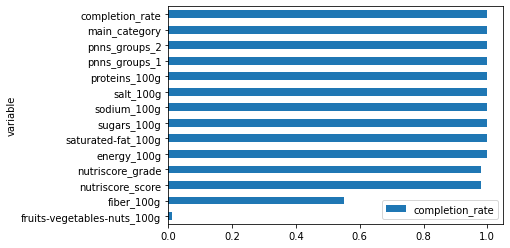

In [16]:
incompletion_rates.plot.barh(x='variable', y='completion_rate');

* Can we estimate the variable `fiber_100g`? see Work by Scarborough et al. => too complicated!

* Can we estimate the variable `fruit-vegetables-nuts_100g`? see Work by Scarborough et al. => too complicated!

On the other hand, the score associated with this variable gives:
- 0 for any product whose contribution is less than 40%
- 1 for any product whose contribution is between 40 and 60%
- 5 for any product whose contribution is greater than 80%!

> Let's build this score and evaluate the current score distribution.

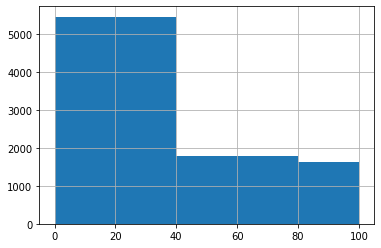

In [17]:
products['fruits-vegetables-nuts_100g'].hist(bins=[0,40,80,100]);

In [18]:
pd.options.mode.chained_assignment = None
products['fruits_vegetables_nuts_score'] = None

products.loc[products['fruits-vegetables-nuts_100g'] >= 80, 'fruits_vegetables_nuts_score'] = 5
products.loc[(products['fruits-vegetables-nuts_100g'] > 60) & (products['fruits-vegetables-nuts_100g'] <= 80),'fruits_vegetables_nuts_score'] = 2
products.loc[(products['fruits-vegetables-nuts_100g'] > 40) & (products['fruits-vegetables-nuts_100g'] <= 60),'fruits_vegetables_nuts_score'] = 1
products.loc[(products['fruits-vegetables-nuts_100g'] >= 0) & (products['fruits-vegetables-nuts_100g'] <= 40),'fruits_vegetables_nuts_score'] = 0

In [19]:
fvn_proportions = products.copy()
fvn_proportions['code'] = fvn_proportions.index
fvn_proportions = fvn_proportions[['code', 'fruits_vegetables_nuts_score']].groupby('fruits_vegetables_nuts_score').count()

print(fvn_proportions)

                              code
fruits_vegetables_nuts_score      
0                             5582
1                             1211
2                              508
5                             1559


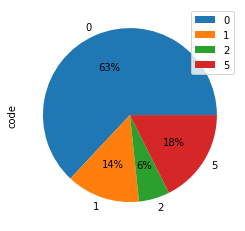

In [20]:
fvn_proportions.plot.pie(y='code', labels=[0,1,2,5], autopct='%1.0f%%');

For referenced products for which this percentage is referenced:
* 63% where it has no impact;
* 14% where it subtracts 1 point from the nutriscore;
* 6% of cases where it deducts 2 points from the nutriscore;
* and 18% of cases where it deducts 5 points from the nutriscore;

Can we draw a sufficiently strong correlation between this score and the product category concerned?


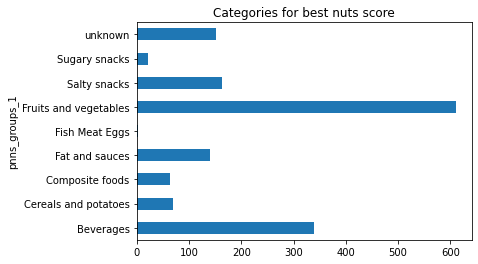

In [21]:
# Best products categories
p = products.copy()
p['code'] = p.index
score_5_products_categories = p[p['fruits_vegetables_nuts_score'] == 5].groupby('pnns_groups_1').count()
score_5_products_categories['code'].plot.barh(title='Categories for best nuts score');

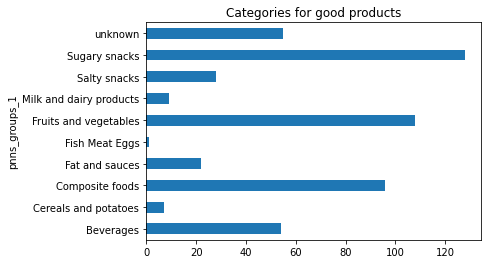

In [22]:
# Good product categories
score_2_products_categories = p[p['fruits_vegetables_nuts_score'] == 2].groupby('pnns_groups_1').count()
score_2_products_categories['code'].plot.barh(title='Categories for good products');

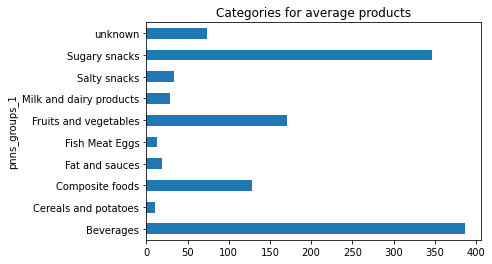

In [23]:
# Average product categories
score_1_products_categories = p[p['fruits_vegetables_nuts_score'] == 1].groupby('pnns_groups_1').count()
score_1_products_categories['code'].plot.barh(title='Categories for average products');

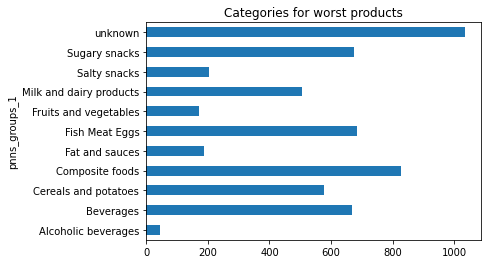

In [24]:
# Worst product categories
score_0_products_categories = p[p['fruits_vegetables_nuts_score'] == 0].groupby('pnns_groups_1').count()
score_0_products_categories['code'].plot.barh(title='Categories for worst products');

It is not obvious that there is a correlation between product category and fruit / nuts / vegetables% score ... maybe with the other variables?

In [25]:
corr = p[['fruits-vegetables-nuts_100g','proteins_100g', 'salt_100g', 'sodium_100g', 'sugars_100g', 'saturated-fat_100g', 'energy_100g']].corr()

corr.style.background_gradient(cmap='RdBu', vmin = -1, vmax = 1)

,fruits-vegetables-nuts_100g,proteins_100g,salt_100g,sodium_100g,sugars_100g,saturated-fat_100g,energy_100g
fruits-vegetables-nuts_100g,1.000000,-0.291656,-0.079536,-0.079536,0.059752,-0.200929,-0.180026
proteins_100g,-0.291656,1.000000,0.309901,0.310505,0.443948,0.155947,0.352292
salt_100g,-0.079536,0.309901,1.000000,0.999995,0.129253,0.035969,0.109266
sodium_100g,-0.079536,0.310505,0.999995,1.000000,0.129505,0.036039,0.109479
sugars_100g,0.059752,0.443948,0.129253,0.129505,1.000000,0.845469,0.221775
saturated-fat_100g,-0.200929,0.155947,0.035969,0.036039,0.845469,1.000000,0.123808
energy_100g,-0.180026,0.352292,0.109266,0.109479,0.221775,0.123808,1.000000


We note here that the variables `salt_100g` and` sodium_100g` are strongly correlated as we expected: we will have to decide which variable we are going to keep for the continuation.


> We are going to build a machine learning model to estimate the nutriscore from sufficiently complete variables __without__ the variable `fruits-vegetables-nuts_100g`

## Process `_100g` variables 

It is not possible for these variables to have negative values ​​or greater than 100 except in the case of `energy_100g`since Kjs are expected and `nutriscore_score` which is a score between -15 and 40.

First, we will deal with the case of `energy_100g`:

In [26]:
products.describe()

,energy_100g,saturated-fat_100g,sugars_100g,sodium_100g,salt_100g,nutriscore_score,fruits-vegetables-nuts_100g,fiber_100g,proteins_100g,completion_rate
count,7.442660e+05,744235.000000,744275.000000,744284.000000,744284.000000,729459.000000,8860.000000,413039.000000,744283.000000,744289.000000
mean,1.231110e+03,5.365215,13.040927,0.592298,1.480662,9.139491,33.297452,2.931025,8.682501,0.886717
std,2.652782e+04,21.204194,75.438250,20.834279,52.187161,8.850833,36.491800,7.911736,85.200078,0.039516
min,0.000000e+00,0.000000,-1.000000,0.000000,0.000000,-15.000000,0.000000,-20.000000,-8.330000,0.770000
25%,4.600000e+02,0.100000,0.700000,0.040000,0.100000,2.000000,0.000000,0.000000,1.800000,0.850000
50%,1.110000e+03,2.000000,3.600000,0.240000,0.600000,10.000000,18.000000,1.600000,6.100000,0.920000
75%,1.686000e+03,7.590000,18.000000,0.552000,1.380000,16.000000,58.000000,3.600000,12.500000,0.920000
max,1.994336e+07,16700.000000,56700.000000,15800.000000,39600.000000,40.000000,100.000000,3330.000000,73000.000000,1.000000


We can see that there are some outliers, in particular that most of the variables exceed the value of 100 while it is a proportion in 100g so the possible values ​​are included in the interval [0; 100].

Let us display the distributions of the variables concerned:

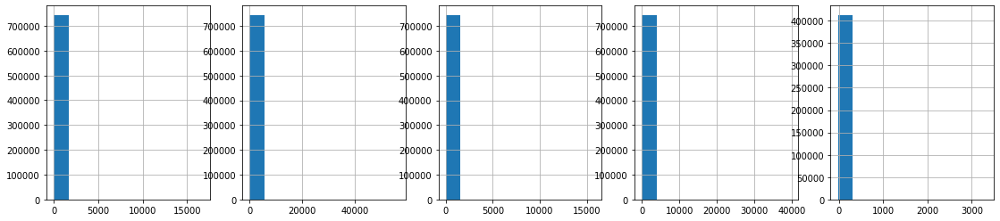

In [27]:
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (19,4)

fig, axs = plt.subplots(1, 5)

products['saturated-fat_100g'].hist(ax=axs[0])
products['sugars_100g'].hist(ax=axs[1])
products['sodium_100g'].hist(ax=axs[2])
products['salt_100g'].hist(ax=axs[3])
products['fiber_100g'].hist(ax=axs[4]);

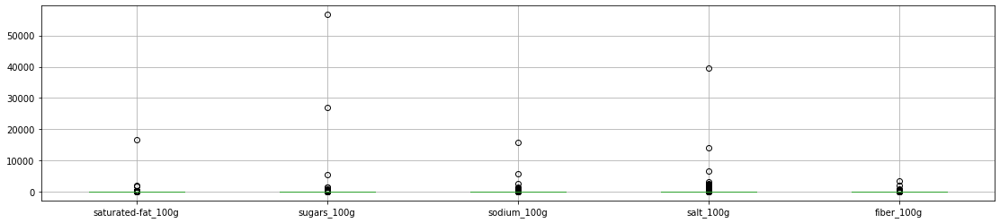

In [28]:
plt.clf()

products[['saturated-fat_100g', 'sugars_100g', 'sodium_100g', 'salt_100g', 'fiber_100g']].boxplot();


There are very few values ​​that are outside the required range:

In [29]:
# Sodium is in mg, so there is no need to apply any transformation (ranges from 0 to 1000mg)
for variable in ['saturated-fat_100g', 'sugars_100g', 'salt_100g', 'fiber_100g']:
  products = products[(products[variable].isna()) | (products[variable] >= 0) & (products[variable] <= 100)]

products

,energy_100g,saturated-fat_100g,sugars_100g,sodium_100g,salt_100g,...,pnns_groups_1,pnns_groups_2,main_category,completion_rate,fruits_vegetables_nuts_score
code,,,,,,,,,,,
0000000000100,936.0,2.2,22.0,1.840,4.60,...,Fat and sauces,Dressings and sauces,en:mustards,0.92,None
0000000000949,134.0,0.1,3.9,0.168,0.42,...,Composite foods,One-dish meals,en:seasoned-shredded-carrots,0.85,None
0000000001281,1594.0,15.5,21.9,0.040,0.10,...,Sugary snacks,Biscuits and cakes,en:coconut-pies,0.92,None
0000000001885,657.0,0.0,27.0,0.000,0.00,...,Fruits and vegetables,Fruits,en:pear-compotes,0.92,None
0000000002257,598.0,1.0,1.0,0.108,0.27,...,Composite foods,One-dish meals,en:vegetables-macedoines,0.85,None
...,...,...,...,...,...,...,...,...,...,...,...
9999991042742,1448.0,17.0,18.0,0.076,0.19,...,unknown,unknown,en:chocolate-mousses,0.85,None
9999991149090,1469.0,0.0,0.0,0.000,0.00,...,Cereals and potatoes,Cereals,en:aromatic-rices,0.85,None
9999999004360,1393.0,6.0,10.4,0.440,1.10,...,unknown,unknown,en:sweet-fritters,0.85,None


### Maximum Kj possible for 100g?

At this stage, we have cleaned up our nutritional variables well with the exception of the variable `energy_100g` which is a bit special since it does not correspond to grams but to kJs according to the documentation.

The most calorific food in terms of energy is oil, for an amount of energy of 900 kcal per 100 grams, or 3768.12 kJ.

> In other words, the maximum possible value in kJ of our series cannot be greater than 3.76e + 03 kJ.

How many lines are affected?



In [30]:
MAX_ENERGY_PRODUCT = 3768.12
too_much_energy_products = products[products['energy_100g'] > MAX_ENERGY_PRODUCT]

print(too_much_energy_products.shape[0])

too_much_energy_products

1335


,energy_100g,saturated-fat_100g,sugars_100g,sodium_100g,salt_100g,...,pnns_groups_1,pnns_groups_2,main_category,completion_rate,fruits_vegetables_nuts_score
code,,,,,,,,,,,
00010016,3899.0,7.20,0.6,0.676,1.69,...,Fish Meat Eggs,Processed meat,en:chipolatas,0.85,None
000147,10594.0,14.00,1.0,0.000,0.00,...,unknown,unknown,en:dietary-supplements,0.92,None
00039244,8400.0,0.10,52.0,0.012,0.03,...,Sugary snacks,Sweets,en:gummi-candies,0.85,None
00053990,3799.0,1.70,5.9,0.400,1.00,...,Composite foods,Sandwiches,en:turkey-sandwiches,0.85,None
0008346026357,6810.0,7.40,38.5,0.000,0.00,...,Composite foods,One-dish meals,en:meal-replacements,0.77,None
...,...,...,...,...,...,...,...,...,...,...,...
95427300,3807.0,5.10,14.9,0.020,0.05,...,unknown,unknown,en:beef-broth,0.85,None
9555022302003,7937.0,7.30,3.5,1.388,3.47,...,Cereals and potatoes,Cereals,en:instant-noodles,0.77,None
9555432804265,3960.0,6.67,40.0,0.900,2.25,...,Sugary snacks,Biscuits and cakes,en:gluten-free-biscuits,0.92,None


Given the small number of elements concerned (reminder: we have more than 61,000 products left), they are being deleted.

In [31]:
products = products[products['energy_100g'] <= MAX_ENERGY_PRODUCT]

products

,energy_100g,saturated-fat_100g,sugars_100g,sodium_100g,salt_100g,...,pnns_groups_1,pnns_groups_2,main_category,completion_rate,fruits_vegetables_nuts_score
code,,,,,,,,,,,
0000000000100,936.0,2.2,22.0,1.840,4.60,...,Fat and sauces,Dressings and sauces,en:mustards,0.92,None
0000000000949,134.0,0.1,3.9,0.168,0.42,...,Composite foods,One-dish meals,en:seasoned-shredded-carrots,0.85,None
0000000001281,1594.0,15.5,21.9,0.040,0.10,...,Sugary snacks,Biscuits and cakes,en:coconut-pies,0.92,None
0000000001885,657.0,0.0,27.0,0.000,0.00,...,Fruits and vegetables,Fruits,en:pear-compotes,0.92,None
0000000002257,598.0,1.0,1.0,0.108,0.27,...,Composite foods,One-dish meals,en:vegetables-macedoines,0.85,None
...,...,...,...,...,...,...,...,...,...,...,...
9999991042742,1448.0,17.0,18.0,0.076,0.19,...,unknown,unknown,en:chocolate-mousses,0.85,None
9999991149090,1469.0,0.0,0.0,0.000,0.00,...,Cereals and potatoes,Cereals,en:aromatic-rices,0.85,None
9999999004360,1393.0,6.0,10.4,0.440,1.10,...,unknown,unknown,en:sweet-fritters,0.85,None


Since we have not arrived at a satisfactory method to complete the variables linked to the proportion of fruits, vegetables and nuts, we delete them:

In [32]:
products.drop(columns=['fruits_vegetables_nuts_score', 'fruits-vegetables-nuts_100g'], inplace = True)
products

,energy_100g,saturated-fat_100g,sugars_100g,sodium_100g,salt_100g,...,proteins_100g,pnns_groups_1,pnns_groups_2,main_category,completion_rate
code,,,,,,,,,,,
0000000000100,936.0,2.2,22.0,1.840,4.60,...,5.1,Fat and sauces,Dressings and sauces,en:mustards,0.92
0000000000949,134.0,0.1,3.9,0.168,0.42,...,0.9,Composite foods,One-dish meals,en:seasoned-shredded-carrots,0.85
0000000001281,1594.0,15.5,21.9,0.040,0.10,...,4.6,Sugary snacks,Biscuits and cakes,en:coconut-pies,0.92
0000000001885,657.0,0.0,27.0,0.000,0.00,...,0.6,Fruits and vegetables,Fruits,en:pear-compotes,0.92
0000000002257,598.0,1.0,1.0,0.108,0.27,...,1.9,Composite foods,One-dish meals,en:vegetables-macedoines,0.85
...,...,...,...,...,...,...,...,...,...,...,...
9999991042742,1448.0,17.0,18.0,0.076,0.19,...,6.0,unknown,unknown,en:chocolate-mousses,0.85
9999991149090,1469.0,0.0,0.0,0.000,0.00,...,7.0,Cereals and potatoes,Cereals,en:aromatic-rices,0.85
9999999004360,1393.0,6.0,10.4,0.440,1.10,...,7.4,unknown,unknown,en:sweet-fritters,0.85


In [33]:
products.describe()

,energy_100g,saturated-fat_100g,sugars_100g,sodium_100g,salt_100g,nutriscore_score,fiber_100g,proteins_100g,completion_rate
count,742602.000000,742560.000000,742588.000000,742597.000000,742597.000000,727817.000000,412320.000000,742596.000000,742602.000000
mean,1165.357351,5.322407,12.916050,0.466539,1.166139,9.119845,2.908284,8.570717,0.886745
std,795.877837,8.039142,18.655871,1.409839,3.521340,8.843818,4.633564,8.946288,0.039513
min,0.000000,0.000000,0.000000,0.000000,0.000000,-15.000000,0.000000,-8.330000,0.770000
25%,460.000000,0.100000,0.700000,0.040000,0.100000,2.000000,0.000000,1.800000,0.850000
50%,1109.000000,2.000000,3.600000,0.240000,0.600000,10.000000,1.600000,6.100000,0.920000
75%,1682.000000,7.580000,18.000000,0.551000,1.377500,16.000000,3.600000,12.500000,0.920000
max,3768.000000,100.000000,100.000000,49.987200,100.000000,40.000000,100.000000,291.000000,1.000000


## Management of categorical variables: Encoding

We will assess their impact on the nutriscore. For this, we can test the correlation between `nutriscore_score` and respectively:

* `main_category`
* `pnns_groups_1`
* `pnns_groups_2`


In [34]:
# Total main categories
print(len(products.main_category.unique()))

# Total PNNS_GROUPS_1
print(len(products.pnns_groups_1.unique()))

# Total PNNS_GROUPS_2
print(len(products.pnns_groups_2.unique()))

23829
11
40


In [35]:
# npps_groups_1 cleaning
products.loc[products['pnns_groups_1'] == 'sugary-snacks', 'pnns_groups_1'] = 'Sugary snacks'
products.loc[products['pnns_groups_1'] == 'salty-snacks', 'pnns_groups_1'] = 'Salty snacks'
products.loc[products['pnns_groups_1'] == 'fruits-and-vegetables', 'pnns_groups_1'] = 'Fruits and vegetables'
products.loc[products['pnns_groups_1'] == 'cereals-and-potatoes', 'pnns_groups_1'] = 'Cereals and potatoes'

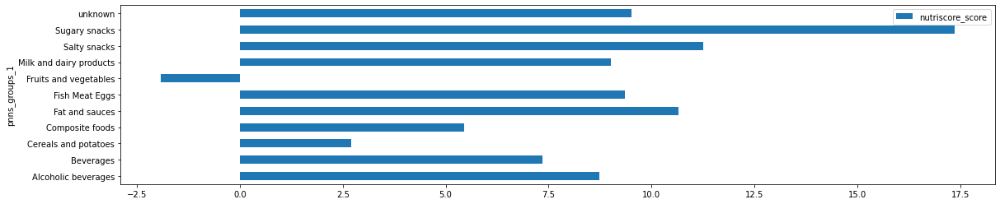

In [36]:
mean_score_per_pnns_1 = products[['nutriscore_score', 'pnns_groups_1']].groupby('pnns_groups_1').mean()

mean_score_per_pnns_1.plot.barh();

In [37]:
print(products['pnns_groups_2'].unique())

# Vegetables
products.loc[products['pnns_groups_2'] == 'legumes', 'pnns_groups_2'] = 'Vegetables'
products.loc[products['pnns_groups_2'] == 'vegetables', 'pnns_groups_2'] = 'Vegetables'
products.loc[products['pnns_groups_2'] == 'Legumes', 'pnns_groups_2'] = 'Vegetables'

# Fruits
products.loc[products['pnns_groups_2'] == 'fruits', 'pnns_groups_2'] = 'Fruits'
products.loc[products['pnns_groups_2'] == 'Fruit juices', 'pnns_groups_2'] = 'Fruits'
products.loc[products['pnns_groups_2'] == 'Dried fruits', 'pnns_groups_2'] = 'Fruits'
products.loc[products['pnns_groups_2'] == 'Fruit nectars', 'pnns_groups_2'] = 'Fruits'

# Cereals
products.loc[products['pnns_groups_2'] == 'cereals', 'pnns_groups_2'] = 'Cereals'
products.loc[products['pnns_groups_2'] == 'Breakfast cereals', 'pnns_groups_2'] = 'Cereals'

# Biscuits and cakes
products.loc[products['pnns_groups_2'] == 'pastries', 'pnns_groups_2'] = 'Biscuits and cakes'
products.loc[products['pnns_groups_2'] == 'Dairy desserts', 'pnns_groups_2'] = 'Biscuits and cakes'

# Milk Based
products.loc[products['pnns_groups_2'] == 'Milk and yogurt', 'pnns_groups_2'] = 'Milk Based'
products.loc[products['pnns_groups_2'] == 'Cheese', 'pnns_groups_2'] = 'Milk Based'
products.loc[products['pnns_groups_2'] == 'Ice cream', 'pnns_groups_2'] = 'Milk Based'

#print(products['pnns_groups_2'].unique())

['Dressings and sauces' 'One-dish meals' 'Biscuits and cakes' 'Fruits'
 'Cheese' 'Meat' 'Bread' 'Fish and seafood' 'Salty and fatty products'
 'Fruit juices' 'Sweets' 'unknown' 'Fats' 'Vegetables' 'Dairy desserts'
 'Pastries' 'Dried fruits' 'Pizza pies and quiches' 'Sweetened beverages'
 'Unsweetened beverages' 'Cereals' 'Nuts' 'Appetizers' 'Processed meat'
 'Breakfast cereals' 'Chocolate products' 'Milk and yogurt' 'Eggs'
 'Plant-based milk substitutes' 'Sandwiches' 'Legumes'
 'Teas and herbal teas and coffees' 'Soups' 'Potatoes'
 'Artificially sweetened beverages' 'Ice cream' 'Offals'
 'Waters and flavored waters' 'Alcoholic beverages' 'Fruit nectars']


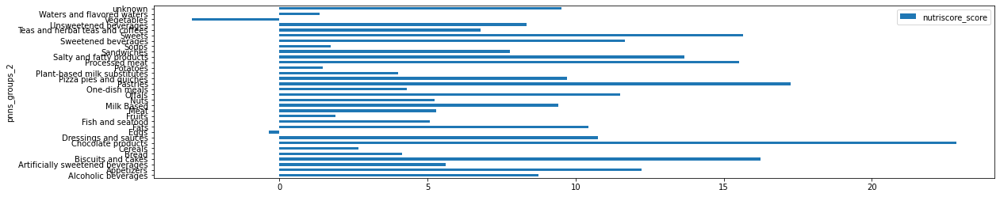

In [38]:
mean_score_per_pnns_2 = products[['nutriscore_score', 'pnns_groups_2']].groupby('pnns_groups_2').mean()

mean_score_per_pnns_2.plot.barh();

It seems that there is a relation between the nutriscore and `pnns_groups_1` and` pnns_groups_2`:

### PNNS V1

In [39]:
import plotly.express as px
fig = px.box(
    products,
    x='pnns_groups_1',
    y='nutriscore_score',
    labels={
        'nutriscore_score': 'Nutriscore',
        'pnns_groups_1': 'PNNS Group (v1)'
    },
    title='Does the PNNS (v1) group have an influence on Nutriscore?'
)
fig.show()

In [40]:
import statsmodels.formula.api as smf
import statsmodels.api as sm

df = products[['nutriscore_score', 'pnns_groups_1']]
df = df.rename(columns={'nutriscore_score': 'nutriscore', 'pnns_groups_1': 'pnns_v1'})
pnns_1_and_nutriscore = smf.ols('nutriscore~pnns_v1', data=df).fit()

sm.stats.anova_lm(pnns_1_and_nutriscore, typ=2)

,sum_sq,df,F,PR(>F)
pnns_v1,1.844776e+07,10.0,34894.588641,0.0
Residual,3.847700e+07,727806.0,NaN,NaN


The p-value is less than 0.05, which makes it possible to reject the hypothesis of independence between these 2 variables. It is therefore imperative to keep `` pnns_v1`` in the construction of our nutriscore prediction model.

### PNNS GROUP 2

In [41]:
fig = px.box(
    products,
    x='pnns_groups_2',
    y='nutriscore_score',
    labels={
        'nutriscore_score': 'Nutriscore',
        'pnns_groups_2': 'PNNS Group (v2)'
    },
    title='Does the PNNS (v1) group have an influence on Nutriscore?'
)
fig.show()

We see that according to the group pnns V2, the distribution of the values ​​is different. Let's check this by ANOVA:

In [42]:
df = products[['nutriscore_score', 'pnns_groups_2']]
df = df.rename(columns={'nutriscore_score': 'nutriscore', 'pnns_groups_2': 'pnns_v2'})
pnns_2_and_nutriscore = smf.ols('nutriscore~pnns_v2', data=df).fit()

sm.stats.anova_lm(pnns_2_and_nutriscore, typ=2)

,sum_sq,df,F,PR(>F)
pnns_v2,2.179481e+07,31.0,14565.221307,0.0
Residual,3.512994e+07,727785.0,NaN,NaN


The p-value is less than 0.05, which makes it possible to reject the hypothesis of independence between these 2 variables. It is therefore imperative to keep `pnns_v2` in the construction of our nutriscore prediction model.

### Main category

In [43]:
products['main_category'].unique()

array(['en:mustards', 'en:seasoned-shredded-carrots', 'en:coconut-pies',
       ..., 'es:gg', 'fr:chips-de-pomme', 'hu:extrudált-kukorica'],
      dtype=object)

Although there may be a relation between `nutrition-score-fr_100g` and` main_category`, we will ignore this variable because of the number of unique values ​​that compose.

We will therefore stick to a model which takes into account 2 qualitative variables: `pnns_groups_1` and` pnns_groups_2`.

Since encoding these variables will lead to a drastic increase in the columns of our dataframe, we will go through the Feature Selection of sklearn (``sklearn.feature_selection.SelectFromBest``) in order to reduce them.

Also, since the encoding of our qualitative variables will produce a lot of numeric columns, we will re-apply a Pearson correlation matrix to eliminate the variables that are too strongly correlated with each other.

In [44]:
# export for futures operations : data encoding et feature selection

products.rename(columns={
    'nutriscore_grade': 'grade',
    'nutriscore_score': 'score',
    'pnns_groups_1': 'group1',
    'pnns_groups_2': 'group2',
    'energy_100g': 'energy',
    'saturated-fat_100g': 'saturated_fat',
    'sugars_100g': 'sugars',
    'sodium_100g': 'sodium',
    'salt_100g': 'salt',
    'fiber_100g': 'fibers',
    'proteins_100g': 'proteins',
}, inplace = True)

to_be_pickled = products[
    [
        'grade',
        'score',
        'group1',
        'group2',
        'energy',
        'saturated_fat',
        'sugars',
        'sodium',
        'salt',
        'fibers',
        'proteins'
    ]
]

to_be_pickled.to_pickle('./../input/cleaned_data.pkl')

## Multivariate analysis : PCA

We already know thanks to the documentation that the nutriscore is using a list of variables, but can we prove it using for instance PCA ?

Can we discover the relationship between nutriscore and these variables ? 

In [45]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Reduction and scaling
scaler = StandardScaler()
dft = to_be_pickled.dropna().copy(deep=True)
nutriscore_grades = dft.grade.values
df_pca = dft.drop(columns=['grade', 'score'], axis='columns').copy(deep=True)
X = df_pca.select_dtypes(include=['float64','int64'])
X_scaled = scaler.fit_transform(X)

# ACP fit/transform
pca = PCA(svd_solver='full').fit(X_scaled)
X_projected = pca.transform(X_scaled)

In [46]:
# PCA functions
from matplotlib.collections import LineCollection
import numpy as np

def display_circles(
    pcs,
    n_comp,
    pca,
    axis_ranks,
    labels=None,
    label_rotation=0,
    lims=None,
    illustrative_var_corr=None,
    illustrative_var_label=None
):
    for d1, d2 in axis_ranks:
        if d2 < n_comp:

            fig, ax = plt.subplots(figsize=(7,6))

            if lims is not None :
                xmin, xmax, ymin, ymax = lims
            elif pcs.shape[1] < 30 :
                xmin, xmax, ymin, ymax = -1, 1, -1, 1
            else :
                xmin, xmax, ymin, ymax = min(pcs[d1,:]), max(pcs[d1,:]), min(pcs[d2,:]), max(pcs[d2,:])

            if pcs.shape[1] < 30 :
                plt.quiver(np.zeros(pcs.shape[1]), np.zeros(pcs.shape[1]),
                   pcs[d1,:], pcs[d2,:], 
                   angles='xy', scale_units='xy', scale=1, color='blue', alpha=0.4)
                # (see : https://matplotlib.org/api/_as_gen/matplotlib.pyplot.quiver.html)
            else:
                lines = [[[0,0],[x,y]] for x,y in pcs[[d1,d2]].T]
                ax.add_collection(LineCollection(lines, axes=ax, alpha=.1, color='blue'))
  
            if labels is not None:  
                for i,(x, y) in enumerate(pcs[[d1,d2]].T):
                    if x >= xmin and x <= xmax and y >= ymin and y <= ymax :
                        plt.text(x, y, labels[i], fontsize='12', ha='center', va='center', rotation=label_rotation, color="blue", alpha=0.8)
            
            # Credits : Michael Fumery
            if illustrative_var_label is not None :
                plt.annotate(illustrative_var_label,
                             (illustrative_var_corr[0,d1],illustrative_var_corr[0,d2]),
                             color='g')

                plt.quiver(np.zeros(pcs.shape[1]), np.zeros(pcs.shape[1]),
                                   illustrative_var_corr[0,d1],illustrative_var_corr[0,d2], 
                                   angles='xy', scale_units='xy', scale=1, color="g", alpha=0.7)

            circle = plt.Circle((0,0), 1, facecolor='none', edgecolor='b')
            plt.gca().add_artist(circle)

            plt.xlim(xmin, xmax)
            plt.ylim(ymin, ymax)
        
            plt.plot([-1, 1], [0, 0], color='grey', ls='--')
            plt.plot([0, 0], [-1, 1], color='grey', ls='--')

            plt.xlabel('F{} ({}%)'.format(d1+1, round(100*pca.explained_variance_ratio_[d1],1)))
            plt.ylabel('F{} ({}%)'.format(d2+1, round(100*pca.explained_variance_ratio_[d2],1)))

            plt.title("Correlation Circle (F{} et F{})".format(d1+1, d2+1))
            plt.show(block=False)
        
def display_factorial_planes(
    X_projected,
    n_comp,
    pca,
    axis_ranks,
    labels=None,
    alpha=1,
    title='',
    illustrative_var=None,
    legend_labels=None
    ):
    for d1,d2 in axis_ranks:
        if d2 < n_comp:
       
            fig = plt.figure(figsize=(7,6))
        
            if illustrative_var is None:
                plt.scatter(X_projected[:, d1], X_projected[:, d2], alpha=alpha)
            else:
                illustrative_var = np.array(illustrative_var)
                for value in np.unique(illustrative_var):
                    selected = np.where(illustrative_var == value)
                    plt.scatter(X_projected[selected, d1], X_projected[selected, d2], alpha=alpha, label=value)
                if legend_labels is None:
                  plt.legend()
                else:
                  plt.legend(legend_labels)
                
            if labels is not None:
                for i,(x,y) in enumerate(X_projected[:,[d1,d2]]):
                    plt.text(x, y, labels[i],
                              fontsize='14', ha='center',va='center') 
                
            boundary = np.max(np.abs(X_projected[:, [d1,d2]])) * 1.1
            plt.xlim([-boundary,boundary])
            plt.ylim([-boundary,boundary])
        
            plt.plot([-100, 100], [0, 0], color='grey', ls='--')
            plt.plot([0, 0], [-100, 100], color='grey', ls='--')

            plt.xlabel('F{} ({}%)'.format(d1+1, round(100*pca.explained_variance_ratio_[d1],1)))
            plt.ylabel('F{} ({}%)'.format(d2+1, round(100*pca.explained_variance_ratio_[d2],1)))

            plt.title("{} (on F{} and F{})".format(title, d1+1, d2+1))
            plt.show(block=False)

def display_scree_plot(pca):
    fig = plt.figure(figsize=(12,9))
    scree = pca.explained_variance_ratio_*100
    plt.bar(np.arange(len(scree))+1, scree)
    plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
    plt.xlabel('rank of the inertia axis')
    plt.ylabel('percentage of inertia')
    plt.title('Scree of eigenvalues')
    plt.show(block=False)

def get_contribution_matrix(X, pca):
    p = X.shape[1]
    pcs = pca.components_
    sqrt_valprop = np.sqrt(pca.explained_variance_)
    corvar = np.zeros((p, p))
    for dim in range(p):
        corvar[:,dim] = pcs[dim,:] * sqrt_valprop[dim]
    
    df = pd.DataFrame({'features': X.columns})
    
    for idx, component in enumerate(pca.components_):
        df[f'CORR_F{idx+1}'] = corvar[:,idx]   

    return df

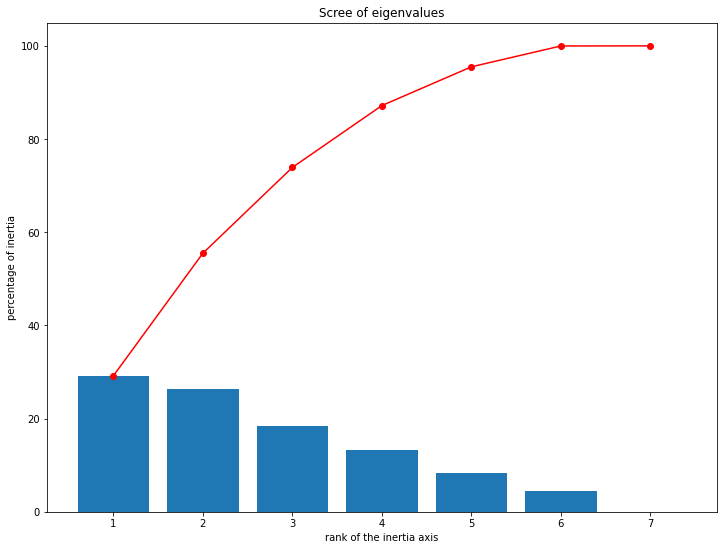

In [47]:
## Display Scree plot

display_scree_plot(pca)

To get a good explanation of the data, we need to consider at least 5 principal components (the projection will explain 85%+ of the data)

In [48]:
### Build contribution matrix
contribution_matrix = get_contribution_matrix(X, pca)

contribution_matrix

,features,CORR_F1,CORR_F2,CORR_F3,CORR_F4,CORR_F5,CORR_F6,CORR_F7
0,energy,-0.237770,0.868670,-0.125520,0.016030,0.035268,-0.414276,3.074342e-06
1,saturated_fat,-0.184107,0.709563,-0.224748,-0.465578,-0.355053,0.263231,-1.113225e-06
2,sugars,-0.286279,0.253241,-0.736057,0.364899,0.377190,0.191605,-4.703222e-06
3,sodium,0.963450,0.212647,-0.151540,0.052026,-0.004003,0.002641,2.923267e-02
4,salt,0.963468,0.212706,-0.151368,0.051946,-0.003990,0.002568,-2.923324e-02
5,fibers,-0.086057,0.420754,0.439315,0.728519,-0.277403,0.121956,-7.614261e-07
6,proteins,0.071730,0.502933,0.665071,-0.208010,0.485541,0.143451,2.937085e-06


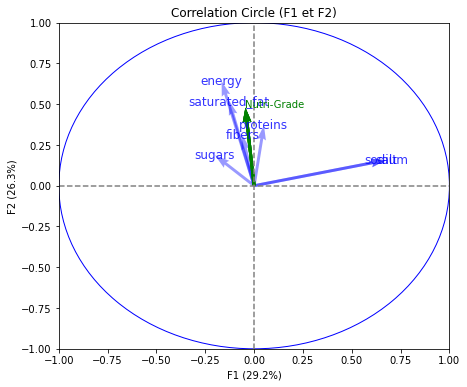

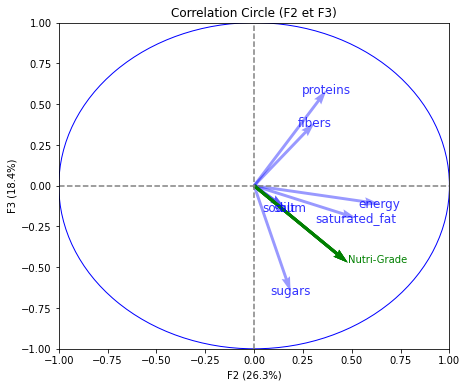

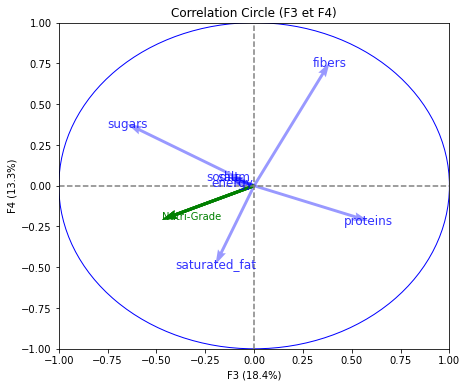

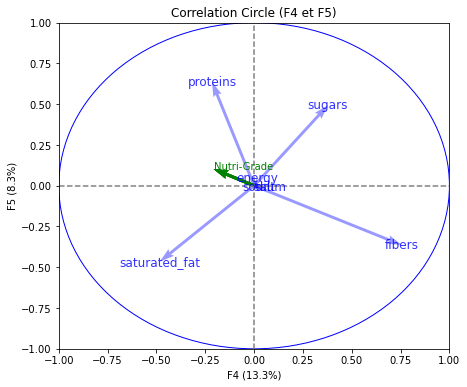

In [49]:
from sklearn.preprocessing import LabelEncoder
encoder = LabelEncoder()

### Encode and build target variable
grades = encoder.fit_transform(nutriscore_grades)
grades = grades.reshape((grades.shape[0],1))

# Evaluate the correlation between the encoded grade AND the components
p = X.shape[1]
corr_grades = np.zeros((grades.shape[1], p))
for j in range(p): 
    for k in range(grades.shape[1]): 
        corr_grades[k,j] = np.corrcoef(grades[:,k],X_projected[:,j])[0,1]


n_components = 5
factorial_planes = [(0,1),(1,2), (2,3), (3,4), (4,5)]

display_circles(
    pca.components_,
    n_components,
    pca,
    factorial_planes,
    labels = np.array(X.columns),
    illustrative_var_label = 'Nutri-Grade',
    illustrative_var_corr = corr_grades
)

### PCA interpretation (Evaluation of the relationship between variables)

#### Projection F1 x F2

* `sodium` is highly and positively correlated to `F1`;
* `energy` is negatively correlated to `F2`;

> The more a product contains sodium, the less is the energy (kJ) provided.

#### Projection F2 x F3

* `energy` and `saturated_fat` are positively correlated to `F2` ;
* `proteins` and `fibers` are positively correlated to `F3` while `sugar` is negatively correlated, so does the `Nutri-Grade`;

> Sugar and Nutri-Grade are opposed to Fiber and Proteins : regarding the formula of nutriscore, this is not surprising.

#### Others Projections

Regardless the factorial plane, the variables `proteins`, `fibers` have an opposite relation to the axis compared to the others variables.

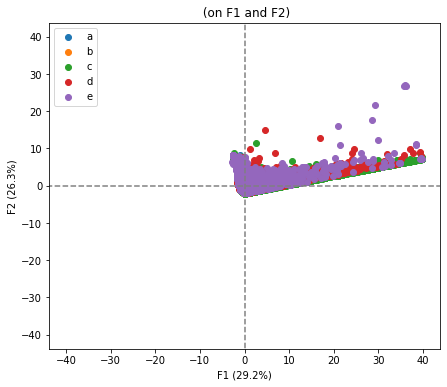

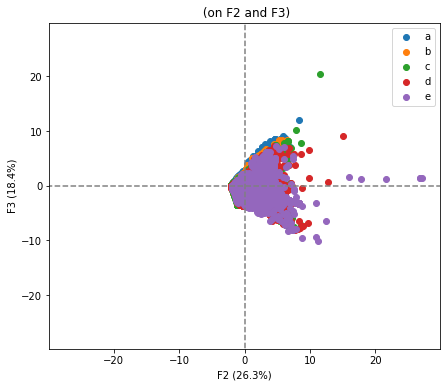

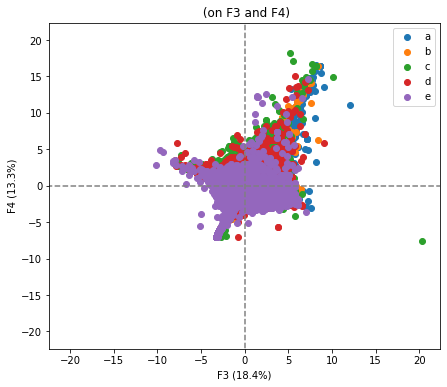

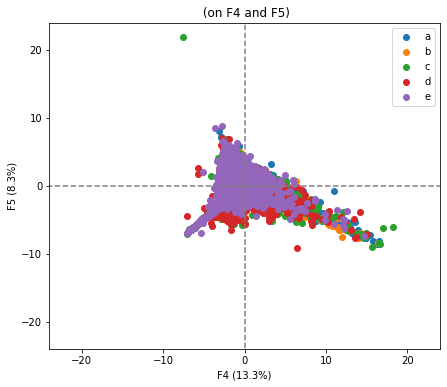

In [50]:
## Projection of products

display_factorial_planes(X_projected, n_components, pca, factorial_planes, illustrative_var=nutriscore_grades)

### Conclusions

As we can see, the projections doesn't allow us to distinct individuals of differents nutrigrades.

This is why we wont add the features obtained using PCA to the final dataset.

In [51]:
print('done')

done
